In [1]:
import sys
sys.executable

'/Users/dio/conda/envs/mapping/bin/python'

In [2]:
import chronomaps as krm

In [3]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from shapely.geometry import Point

In [4]:
# import mpl_toolkits
# mpl_toolkits.__path__.append('/usr/local/lib/python2.7/dist-packages/mpl_toolkits/')
from mpl_toolkits.basemap import Basemap

In [5]:
import geonamescache
gc = geonamescache.GeonamesCache()
cities_us = [gc.get_cities()[ci] for ci in gc.get_cities().keys() if gc.get_cities()[ci]['countrycode']=='US']

In [6]:
# define green/yellow/red colormap
cmap = mpl.colors.LinearSegmentedColormap.from_list('GreenYellowRed',[(0,'limegreen'), (0.5,'gold'),(0.9,'darkred'),(1., 'maroon')])

In [7]:
def grid_is_land(grid, resolution='l'):
    """Given a list of (lat,lon) points, return only the points that are on land, according to the GSHHG shoreline database.
    The resolution level can be specified as input ('l'=low,'i'=intermediate,'h'=high,'f'=full, usually intermediate is 
    good enough, for maps that span less than ~100 miles should be used)"""
    y, x = zip(*grid)
    themap = Basemap(llcrnrlon=min(x),llcrnrlat=min(y),urcrnrlon=max(x),urcrnrlat=max(y), resolution=resolution)
    grid_out = [p for p in grid if themap.is_land(p[1],p[0])]
    return grid_out

In [8]:
def make_grid_map(x,y, service='shadedrelief', xpixels=500, EPSG = 2229):
    """Overlays a grid of points (passed as x,y for longitude, latitude) on a map, which is by default shaded relief
    (from www.shadedrelief.com). Can also use arcGIS ESRI map services (e.g. StreetMap_World).
    The EPSG code defines the map projection (default value here covers Southern California).
    """
    fig, ax = plt.subplots(figsize = (6, 6))
    themap = Basemap(llcrnrlon=min(x),llcrnrlat=min(y),urcrnrlon=max(x),urcrnrlat=max(y), epsg=EPSG, ax=ax)
    if service == 'shadedrelief': themap.shadedrelief()
    else: themap.arcgisimage(service='ESRI_StreetMap_World_2D',xpixels=xpixels)
    xm, ym = themap(x,y)
    ax.scatter(xm,ym,s=4,c='k')
    return fig, themap

In [61]:
from matplotlib.patches import Path, PathPatch, Polygon, Wedge

def patch_mask_oceans_lakes(themap, ax, aquacolor='lightcyan', lw=0):
    """
    Create a water-blue patch covering up water bodies (oceans and lakes).
    Ocean-masking code taken from https://stackoverflow.com/questions/48620803/fill-oceans-in-basemap
    """
    # fill lakes
    for lake in  [p.boundary for p in themap.lakepolygons]:
        ax.add_patch(Polygon(lake,facecolor=aquacolor,lw=lw,zorder=99))
    
    # fill oceans
    (x0,x1),(y0,y1) = ax.get_xlim(), ax.get_ylim()
    map_edges = np.array([[x0,y0],[x1,y0],[x1,y1],[x0,y1]])
    # map_edges = map(lambda x: themap(*x),[LL, [UR[0],LL[1]],UR,[LL[0],UR[1]]])
    polys = [map_edges]+[p.boundary for p in themap.landpolygons]
    
    ##creating a PathPatch
    codes = [ [Path.MOVETO] + [Path.LINETO for p in p[1:]] for p in polys ]
    polys_lin = [v for p in polys for v in p]
    codes_lin = [c for cs in codes for c in cs]
    patch = PathPatch(Path(polys_lin, codes_lin),facecolor=aquacolor, lw=lw, zorder=99)
    ax.add_patch(patch)
    return ax

In [62]:
levels=range(0,270+1,30)
def make_contour_map(x,y,z, ax, pos0='', service='ESRI_StreetMap_World_2D', levels=levels, xpixels=500, EPSG = 2229, resolution='l',
                     cbarlabel='Travel Times (minutes)', rebox=0.1, cbarfraction=0.045, cbarextend='max'):
    if isinstance(rebox,(list,tuple)) and len(rebox)==4: LL, UR = (rebox[0], rebox[1]), (rebox[2], rebox[3])
    else: LL , UR = (min(x)+rebox, min(y)+rebox), (max(x)-rebox, max(y)-rebox)
    
    themap = Basemap(llcrnrlon=LL[0],llcrnrlat=LL[1],urcrnrlon=UR[0],urcrnrlat=UR[1], epsg=EPSG, ax=ax, resolution=resolution)
    if service == 'shadedrelief': themap.shadedrelief()
    else: themap.arcgisimage(service='ESRI_StreetMap_World_2D',xpixels=xpixels)
    themap.drawcoastlines(linewidth=0.5)
    
    xm, ym = themap(x,y)
    (z, levels) = (np.array(z)/60., np.array(levels)/60.) if 'hours' in cbarlabel else (z, levels)
    
    cols = [cmap(1.*lev/levels[-1]) for lev in levels]
    ax.tricontour(xm,ym,z, levels=levels, colors=map(lambda c: krm.lighten_color(c,1.2), cols),linewidths=1)
    im=ax.tricontourf(xm,ym,z, levels=levels, colors=cols, alpha=0.5, antialiased=True,extend=cbarextend)
    cb = plt.colorbar(im, ax=ax, label=cbarlabel, fraction=cbarfraction, extendfrac=0.)
    cb.set_alpha(0.7)
    cb.draw_all()
    ax = patch_mask_oceans_lakes(themap, ax, aquacolor='lightcyan')
    if not pos0=='': 
        ax.scatter(*themap(pos0[1],pos0[0]), marker='x',c='k', s=20, zorder=100)
    return ax

### Test Google Maps API calls

In [32]:
city = [ci for ci in cities_us if ci['name']=='Irvine'][0]
city

{u'countrycode': u'US',
 u'geonameid': 5359777,
 u'latitude': 33.66946,
 u'longitude': -117.82311,
 u'name': u'Irvine',
 u'population': 256927,
 u'timezone': u'America/Los_Angeles'}

In [24]:
pos = krm.call_Gmaps_coords_from_address('Irvine, CA')
pos

[33.6845673, -117.8265049]

Make rectangular grid by calling `make_xy_grid`: make_xy_grid(p0, max_time, nx, ny, max_speed=70.0). 

By setting max_speed=1 (mph), I transform the max_time specification to a distance specification. So here I make a grid with a 20 miles radius.

In [34]:
grid = krm.make_xy_grid(pos, max_time=20, nx=10, ny=10, max_speed=1.)
grid1 = grid_is_land(grid)

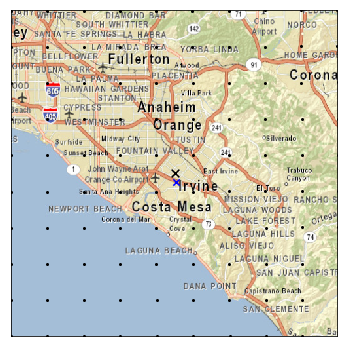

In [48]:
fig, themap = make_grid_map(zip(*grid)[1], zip(*grid)[0], service='')
fig.gca().scatter(*themap(city['longitude'],city['latitude']),marker='x',c='b',s=40)
fig.gca().scatter(*themap(pos[1],pos[0]),marker='x',c='k',s=60);

In the figure above, I show the 10x10 grid centered around Irvine. To be precise, it is centered on the position that Google Maps returns when searching Irvine (black cross). The GeoNamesCache position for Irvine is slightly different (blue cross), as is the map point sown by ArcGIS.

We will now run the Google Maps API for travel distances between the center and each point on the grid (to save API calls, just run the points that fall on land).

In [49]:
_, times, dists = krm.run_travel_grid(pos, grid1)

Hopefully this should have run without errors!   
Now make a contour plot of travel times. This is based on a coarse grid, so it will not look great.

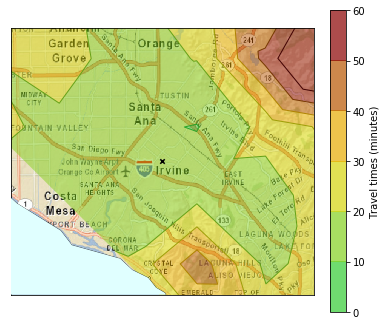

In [55]:
fig, ax = plt.subplots(figsize=(6,6))
ax = make_contour_map(zip(*grid1)[1],zip(*grid1)[0],np.array(times)/60., ax, pos0=pos, levels = range(0,60+1,10),
                      cbarlabel='Travel times (minutes)',resolution='h')

# first kronomap: Irvine, CA

In [11]:
# pos0 = krm.call_Gmaps_coords_from_address('Irvine, CA')
city = [ci for ci in cities_us if ci['name']=='Irvine'][0]
pos0 = [city['latitude'], city['longitude']]
pos0

[33.66946, -117.82311]

In [12]:
grid = krm.make_mixed_grid(pos0, max_time=2.5, n_radial=20, n_angles=24, nx=24, ny=24, max_speed = 70.)
grid += krm.make_xy_grid(pos0, max_time=10, nx=10, ny=10,max_speed=1)
print 'initial grid size: ', len(grid)
grid = grid_is_land(grid)
print 'number of points on land',len(grid)

initial grid size:  1157
number of points on land 691


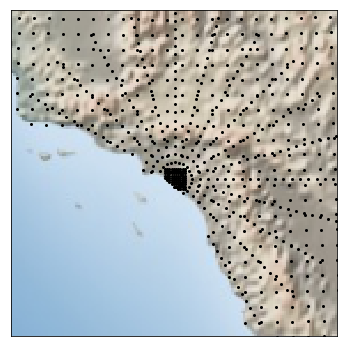

In [13]:
_=make_grid_map(zip(*grid)[1], zip(*grid)[0])

Run Google Maps Distance Matrix API on the grid (should take up to 20 seconds)

In [14]:
grid0, times, dists = krm.run_travel_grid(pos0, grid)

### load/save travel times to disk

In [15]:
# protects from inadvertedly overwriting the saved data - use flag_save=True to actually save the data
flag_save = not True
if flag_save:
    np.savez('data/grid_LA.npz', grid=grid, times=times, dists=dists)

In [23]:
npzinput = np.load('data/grid_LA.npz')
grid = npzinput['grid']
dists = npzinput['dists']
times = npzinput['times']

## make travel plots

In [28]:
levels=range(0,270+1,30)
cols = [cmap(1.*lev/levels[-1]) for lev in levels]

In [25]:
y,x = zip(*grid)
z = np.array(times)/60. #minutes
xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])

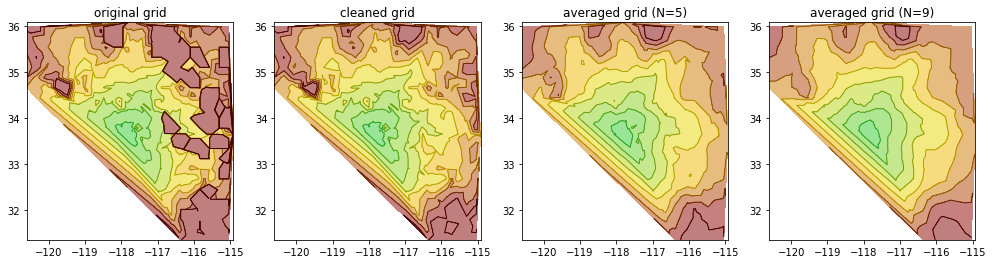

In [29]:
fig, axes = plt.subplots(1,4,figsize=(17,4))
for iax, ax in enumerate(axes):
    tmp=[[x,y,z],[xx,yy,zz], krm.smoothen2d(xx,yy,zz,5), krm.smoothen2d(xx,yy,zz,9)][iax]
    ax.tricontourf(*tmp, levels=levels,colors=cols, alpha=0.5,extend='max')
    ax.tricontour(*tmp, levels=levels,colors=map(lambda c: krm.lighten_color(c,1.2), cols),linewidths=1)
    ax.set_title(['original grid','cleaned grid','averaged grid (N=5)','averaged grid (N=9)'][iax])

Overwrite the travel times with the times averaged with N=5  (NB: effectively this means each point is averaged with 4 nearest neighbors)

In [30]:
zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])

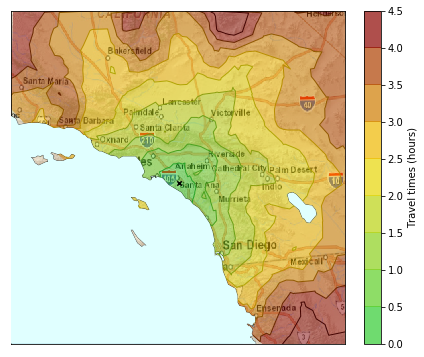

In [33]:
fig, ax = plt.subplots(figsize=(6,6))
ax = make_contour_map(xx,yy,zz,ax,pos0=pos0, levels = levels, cbarlabel='Travel times (hours)',resolution='i')
fig.tight_layout();
fig.savefig('figs/travel_map_Irvine.png')

Zoom-in to regions that can be reached within 1 hour

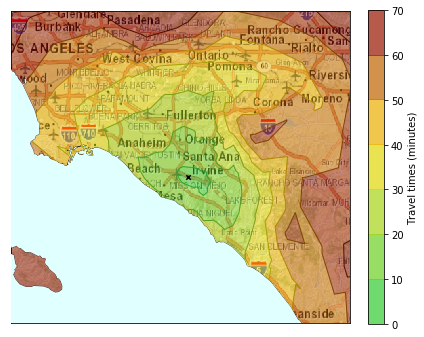

In [34]:
zoom_levels = range(0,71,10)
fig, ax = plt.subplots(figsize=(6,6))
ax = make_contour_map(xx,yy,zz,ax,pos0=pos0, levels = zoom_levels, cbarlabel='Travel times (minutes)',resolution='h', 
                      rebox=((-118.5,33.2,-117.2,34.2)), cbarfraction=0.042)
fig.tight_layout();
fig.savefig('figs/travel_map_Irvine_zoom.png')

## make animation

In [78]:
from matplotlib import animation, rc, rcParams
from IPython.display import HTML
rc('animation', html='html5')
rc('animation', embed_limit=200.)

Make an animation with color spewing from the center, filling the map from the center out. We make a new frame for every 5 minutes increment in travel time, and we overlay thicker contours every 30 minutes. 

Note: This takes a while (couple of minutes) to visualize in the Jupyter notebook and to save to file.

In [79]:
norm_levels = range(0,270+1,30)
fine_levels = np.arange(0,300+1,5)
fine_cols = [cmap(1.2*lev/norm_levels[-1]) for lev in fine_levels]

fig, ax = plt.subplots(figsize=(6,6))
fig.tight_layout()

def animate(i):
    rebox=0.1
    ax.clear()
    themap = Basemap(llcrnrlon=min(xx)+rebox,llcrnrlat=min(yy)+rebox,urcrnrlon=max(xx)-rebox,urcrnrlat=max(yy)-rebox, epsg=2229, ax=ax, resolution ='i')
    themap.arcgisimage(service='ESRI_StreetMap_World_2D',xpixels=800)
    ax1 = patch_mask_oceans_lakes(themap, ax, aquacolor='lightcyan')
    xm, ym = themap(xx,yy)
    
    levs = [lev for lev in norm_levels if lev <= fine_levels[i]]
    if len(levs)>1: ax.tricontour(xm,ym,zz,levels=levs, colors=map(lambda c: krm.lighten_color(c,1.2), cols[:norm_levels.index(levs[-1])]),linewidths=1)
    ax.tricontourf(xm,ym,zz,levels=fine_levels[:i+1],colors=fine_cols[:i+1], alpha=0.5, antialiased=True)
    ax.annotate('Travel time: '+krm.sec_to_hms(fine_levels[i]*60)[:-2], xy=(0,1.01), xycoords='axes fraction')
    
    ax.scatter(*themap(pos0[1],pos0[0]), marker='x',c='k', s=20, zorder=100)

# animate(20)
anim = animation.FuncAnimation(fig, animate, frames=range(1,len(fine_levels)), interval=100)
plt.close()

In [80]:
HTML(anim.to_jshtml())

In [81]:
anim.save('animations/animation_LA.mp4')

Convert the mp4 file to GIF with ffmpeg (could also have saved animation to gif with `imagemagick` writer). Replace `-hide_banner` with `-loglevel quiet` to suppress all output.    
Commented out is a more advanced ffmpeg command that will save a higher-quality GIF (but ~4x bigger file size)

In [82]:
! ffmpeg -y -hide_banner -i animations/animation_LA.mp4 animations/animation_LA.gif 
# ! ffmpeg -y -hide_banner -i animations/animation_LA.mp4 -filter_complex "[0:v] split [a][b];[a] palettegen [p];[b][p] paletteuse" animations/animation_LA1.gif

Input #0, mov,mp4,m4a,3gp,3g2,mj2, from 'animations/animation_LA.mp4':
  Metadata:
    major_brand     : isom
    minor_version   : 512
    compatible_brands: isomiso2avc1mp41
    encoder         : Lavf57.83.100
  Duration: 00:00:06.00, start: 0.000000, bitrate: 184 kb/s
    Stream #0:0(und): Video: h264 (High) (avc1 / 0x31637661), yuv420p, 432x432, 182 kb/s, 10 fps, 10 tbr, 10240 tbn, 20 tbc (default)
    Metadata:
      handler_name    : VideoHandler
Stream mapping:
  Stream #0:0 -> #0:0 (h264 (native) -> gif (native))
Press [q] to stop, [?] for help
[swscaler @ 0x7f9fc5099400] No accelerated colorspace conversion found from yuv420p to bgr8.
Output #0, gif, to 'animations/animation_LA.gif':
  Metadata:
    major_brand     : isom
    minor_version   : 512
    compatible_brands: isomiso2avc1mp41
    encoder         : Lavf57.83.100
    Stream #0:0(und): Video: gif, bgr8, 432x432, q=2-31, 200 kb/s, 10 fps, 100 tbn, 10 tbc (default)
    Metadata:
      handler_name    : VideoHandler
     

# interactive map with `mplleaflet `

In [54]:
import mplleaflet

In [145]:
npzinput = np.load('data/grid_LA.npz')
grid = npzinput['grid']
dists = npzinput['dists']
times = npzinput['times']

In [146]:
y,x = zip(*grid)
z = np.array(times)/60. #minutes
xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])
zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])

In [147]:
fig, ax = plt.subplots(1,1,figsize=(5,4))
levels=range(0,270+1,30)
cols = [cmap(1.*lev/levels[-1]) for lev in levels]
ax.tricontourf(xx,yy,zz, levels=levels,colors=cols,extend='max')
mplleaflet.display(fig=ax.figure, closefig=False)

The box (which includes every point above last time level) does not look great. I can have the same plot looking nice if I    reduce the value for the last contour:

In [148]:
fig, ax = plt.subplots(1,1,figsize=(5,4))
levels = range(0,180+1,30)
cols = [cmap(0.9*lev/levels[-1]) for lev in levels]
ax.tricontourf(xx,yy,zz, levels=levels,colors=cols,alpha=0.5)
ax.tricontour(xx,yy,zz, levels=levels,colors=map(lambda c: krm.lighten_color(c,1.2), cols),linewidths=1);
mplleaflet.display(fig=ax.figure, closefig=False)

In [149]:
mplleaflet.show(fig=ax.figure, path='figs/travel_map_Irvine.html')

In [150]:
def fix_mplleaflet_alpha(filename, alpha=0.5):
    with open(filename, 'r') as f:
        s = f.read()
    with open(filename, 'w') as f:
        s = s.replace('"fillColor": ', '"fillOpacity":"0.5", "fillColor": ')
        f.write(s)

In [151]:
fix_mplleaflet_alpha('figs/travel_map_Irvine.html')

# sample of US cities

In [35]:
cities_list = ['San Francisco', 'Seattle', 'Denver', 'Chicago', 'Washington, D.C.', 'New York City']
short_name_list = ['SF','Sea','Den','Chi','DC','NY']
epsg_list = [2226, 2285, 2773, 3435, 2248, 2263]
# pos0_list = [ krm.call_Gmaps_coords_from_address(city) for city in cities_list ]
pos0_list=[]
for name in cities_list:
    city = [ci for ci in cities_us if name == ci['name']][0]
    pos0_list.append([city['latitude'], city['longitude']])

In [36]:
themap_list = []
grid_list = []
for idx in range(len(cities_list)):
    tmpgrid = krm.make_mixed_grid(pos0_list[idx], 2.5, 20, 24, 24, 24) 
    tmpgrid += krm.make_xy_grid(pos0_list[idx], max_time=10, max_speed=1, nx=10, ny=10)
    tmpgrid = grid_is_land(tmpgrid)
    grid_list.append(tmpgrid)
    y, x = zip(*tmpgrid)
    themap_list.append(Basemap(llcrnrlon=min(x),llcrnrlat=min(y),urcrnrlon=max(x),urcrnrlat=max(y), epsg=epsg_list[idx]))

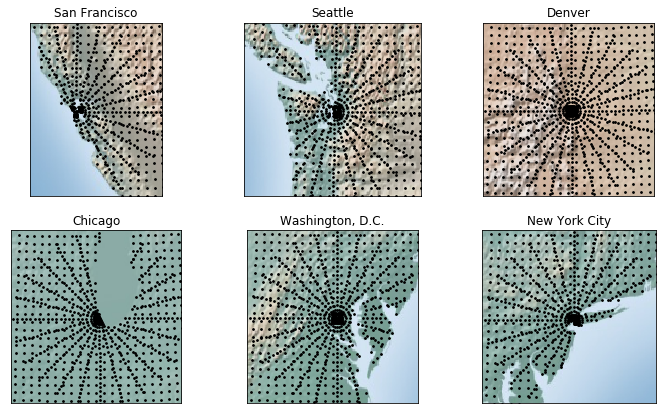

In [37]:
fig, axes = plt.subplots(2,3,figsize=(12,7))

for idx in range(len(cities_list)):
    ax = axes[idx//3][idx%3]
    themap = themap_list[idx]
    themap.shadedrelief(ax=ax)
    tmpgrid = grid_list[idx]
    y, x = zip(*tmpgrid)
    ax.scatter(*themap(x,y),s=3, c='k')
    ax.set_title(cities_list[idx])

In [86]:
print 'points in grids:', [len(tmpgrid) for tmpgrid in grid_list]

points in grids: [568, 799, 1065, 879, 903, 692]


Run Google Maps API for each grid

In [38]:
dists_list, times_list = [], []
for idx in range(len(cities_list)):
    gg, tt, dd = krm.run_travel_grid(pos0_list[idx], grid_list[idx])
    dists_list.append(dd)
    times_list.append(tt)

### save/load data

In [39]:
# protects from inadvertedly overwriting the saved data
flag_save = not True
if flag_save:
    for idx in range(len(cities_list)):
        np.savez('data/grid_'+short_name_list[idx]+'.npz', grid=grid_list[idx], times=times_list[idx], dists=dists_list[idx])

In [40]:
grid_list, dists_list, times_list = [], [], []

for idx in range(len(cities_list)):
    npzinput = np.load('data/grid_'+short_name_list[idx]+'.npz')
    grid_list.append(npzinput['grid'])
    dists_list.append(npzinput['dists'])
    times_list.append(npzinput['times'])

## make figures

In [41]:
levels=range(0,210+1,30)
cols = [cmap(1.*lev/levels[-1]) for lev in levels]

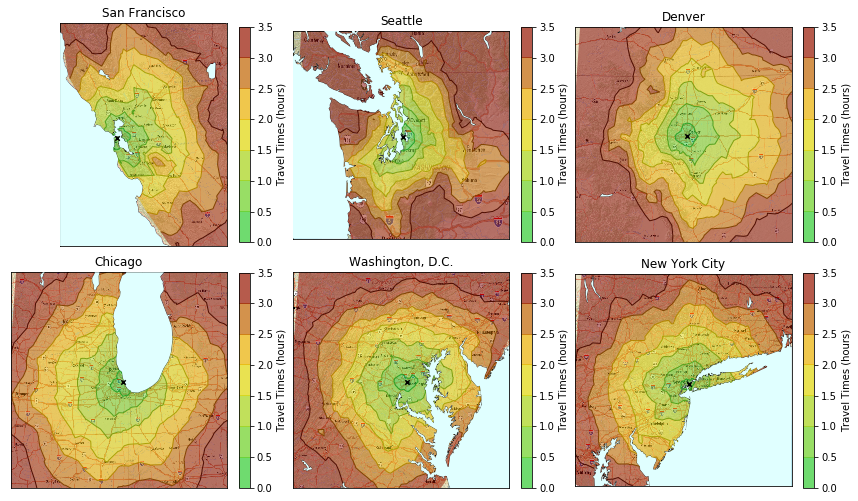

In [43]:
fig, axes = plt.subplots(2,3,figsize=(12,7))

for idx in range(len(cities_list)):
    ax = axes[idx//3][idx%3]
    
    y, x = zip(*grid_list[idx])
    z = np.array(times_list[idx])/60. #minutes
    xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])
    zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])
    ax = make_contour_map(xx,yy,zz, ax, pos0=pos0_list[idx], levels=levels, EPSG=epsg_list[idx], resolution='i',
                         xpixels=700, cbarlabel='Travel Times (hours)',rebox=0.15)
    ax.set_title(cities_list[idx])
fig.subplots_adjust(left=0.02, right=0.95, top=0.95, bottom=0.02, wspace=0.18, hspace=0.1)
fig.savefig('figs/grid_cities_map.png',dpi=120)


Individually save each of these plots

In [44]:
for idx in range(len(cities_list)):
    fig, ax = plt.subplots(figsize=(6,6))
    
    y, x = zip(*grid_list[idx])
    z = np.array(times_list[idx])/60. #minutes
    xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])
    zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])
    ax = make_contour_map(xx,yy,zz, ax, pos0=pos0_list[idx], levels=levels, EPSG=epsg_list[idx], resolution='i',
                         xpixels=700, cbarlabel='Travel Times (hours)',rebox=0.15)
    ax.set_title(cities_list[idx])
    fig.tight_layout()
    fig.savefig('figs/travel_times_map_'+short_name_list[idx]+'.png')
    plt.close()

Now we repeat the same figures but zooming in into the 1 hour range.

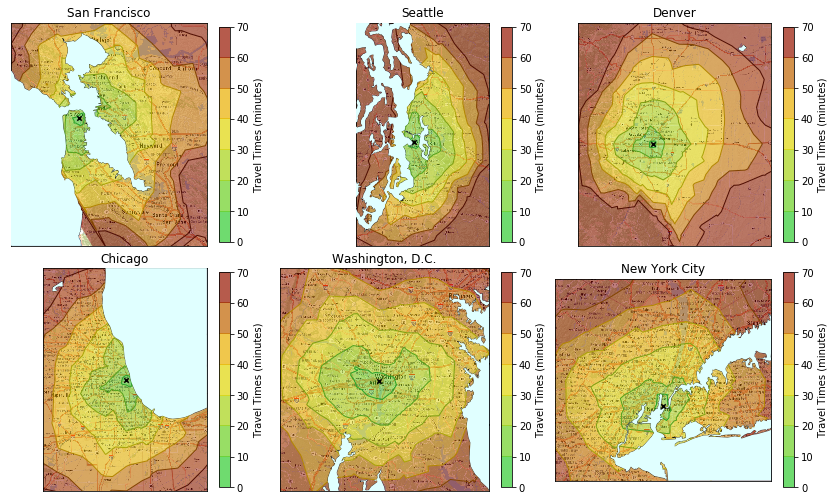

In [46]:
fig, axes = plt.subplots(2,3,figsize=(12,7))
rebox_list=[[-122.8,37.2,-121.7,38.2],[-122.8,47,-121.7,48.3],[-105.6,39.1,-104,40.5],[-88.3,41.2,-87,42.5],[-77.6,38.4,-76.4,39.4],[-74.6,40.4,-73.4,41.25]]
for idx in range(len(cities_list)):
    ax = axes[idx//3][idx%3]
    
    y, x = zip(*grid_list[idx])
    z = np.array(times_list[idx])/60. #minutes
    xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])
    zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])
    ax = make_contour_map(xx,yy,zz, ax, pos0=pos0_list[idx], levels=range(0,71,10), EPSG=epsg_list[idx], resolution='h',
                        xpixels=700, cbarlabel='Travel Times (minutes)',rebox=rebox_list[idx])
    ax.set_title(cities_list[idx])
fig.subplots_adjust(left=0.02, right=0.95, top=0.95, bottom=0.02, wspace=0.18, hspace=0.1)
fig.savefig('figs/grid_cities_map_zoom.png',dpi=120)

In [47]:
for idx in range(len(cities_list)):
    fig, ax = plt.subplots(figsize=(6,6))
    
    y, x = zip(*grid_list[idx])
    z = np.array(times_list[idx])/60. #minutes
    xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])
    zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])
    #ax.set(xlim=(aa[0],aa[2]),ylim=(aa[1],aa[3]))
    ax = make_contour_map(xx,yy,zz, ax, pos0=pos0_list[idx], levels=range(0,71,10), EPSG=epsg_list[idx], resolution='h',
                        xpixels=700, cbarlabel='Travel Times (minutes)',rebox=rebox_list[idx])
    ax.set_title(cities_list[idx])
    fig.tight_layout()
    fig.savefig('figs/travel_times_map_'+short_name_list[idx]+'_zoom.png')
    plt.close()

### interactive map

In [152]:
levels = range(0,180+1,30)
cols = [cmap(0.9*lev/levels[-1]) for lev in levels]
for idx in range(len(cities_list)):
    fig, ax = plt.subplots(1,1,figsize=(5,4))
    y, x = zip(*grid_list[idx])
    z = np.array(times_list[idx])/60. #minutes
    xx, yy, zz = zip(*[ el for el in zip(x,y,z) if el[-1]!=1000000./60])
    zz = np.array(krm.smoothen2d(xx,yy,zz,5)[-1])

    ax.tricontourf(xx,yy,zz, levels=levels,colors=cols,alpha=0.5)
    ax.tricontour(xx,yy,zz, levels=levels,colors=map(lambda c: krm.lighten_color(c,1.2), cols),linewidths=1);
    mplleaflet.show(fig=ax.figure, path='figs/travel_map_'+short_name_list[idx]+'.html')
    fix_mplleaflet_alpha('figs/travel_map_'+short_name_list[idx]+'.html')
                    

We are done here! Head over to the [kronomaps.ipynb](kronomaps.ipynb) notebook to make beautiful kronomaps, that is, maps where the radial distance from the origin is given by travel times instead of the distance measured along Earth's surface.